## Solving PDEs with the Finite Difference Method

- Datasets in the lesson are available through: [https://www.kaggle.com/datasets/yhzang32/2025-course-dl4pde](https://www.kaggle.com/datasets/yhzang32/2025-course-dl4pde)

## (1) Solving the 1d Poisson equation with FDM
$$
- k\frac{d^2u}{dx^2} = f(x), \quad x \in [0,1]
$$
where $k=0.001$, $f(x)=\sin(2\pi x)$ and Dirichlet boundary condition is considered (i.e. $u(0)=u_0, u(1)=u_1$).

### （1.1）The discretization of the PDE
With the second-order derivative approximation, we can discretize the PDE as follows:
\begin{equation}
- k \frac{u_{i+1} - 2u_i + u_{i-1}}{\Delta x^2} = f(x_i), \quad i=1,\cdots,N-1 \tag{1}
\end{equation}


We denote
$$
\vec{u} = [u_1, u_2, \cdots, u_{N-1}]^T,
$$
Then $(1)$ can be formulated as the following linear system:
\begin{equation}
- \frac{k}{\Delta x^2} \left[
\begin{matrix}
-2 & 1 & \cdots & \cdots \\
1 & -2 & \cdots & \cdots \\
\vdots & \vdots & \ddots & 1 \\
\cdots & \cdots & 1 & -2 \\
\end{matrix}
\right] \vec{u} =
\left[
\begin{matrix}
\frac{k}{\Delta x^2}u_0 \\
0 \\
\cdots \\
0 \\
\frac{k}{\Delta x^2}u_N \\
\end{matrix}
\right] +
\left[
\begin{matrix}
 f(x_1)\\
f(x_2) \\
\cdots \\
f(x_{N-2}) \\
 f(x_{N-1})\\
\end{matrix}
\right]
\end{equation}
We denote it as:
$$
A\tilde{u} = b.
$$
The above system is then solved with the built-in method [```numpy.linalg.solve```](https://numpy.org/doc/2.0/reference/generated/numpy.linalg.solve.html) in ```numpy```.

In [1]:
import numpy as np
import matplotlib.pyplot as plt

def get_A(N, kapa, dx):
    """
    Construct the finite-difference stiffness matrix A
    for the 1D second-derivative operator with Dirichlet BCs.

    The matrix corresponds to the discretization of:
        -kappa * u_xx
    using central differences on N+1 grid points.
    """
    # Initialize an (N-1) x (N-1) matrix for interior grid points
    # N is the number of subintervals, so there are N-1 interior points (u_1 to u_{N-1}).
    A = np.zeros(shape=(N-1, N-1))

    # Fill the tridiagonal matrix
    for j in range(N-1):
        if j > 0:
            # Lower diagonal (coefficient for u_{i-1})
            A[j, j-1] = 1

        # Main diagonal (coefficient for u_i)
        A[j, j] = -2

        if j < N-2:
            # Upper diagonal (coefficient for u_{i+1})
            A[j, j+1] = 1

    # Scale by -kappa / dx**2 to represent the full operator: -k * D_xx
    # where D_xx is the central difference matrix for the second derivative.
    return -A * kapa / dx**2


def get_b(N, kapa, dx, u0, uN):
    """
    Construct the right-hand-side vector b for the linear system.

    This includes:
    - the forcing term f(x) = sin(2πx)
    - contributions from Dirichlet boundary conditions
    """
    # Generate the full grid (N+1 points, including boundaries at 0 and 1)
    x = np.linspace(0., 1., N+1)

    # Evaluate the forcing term f(x) at interior points (x_1 to x_{N-1})
    b = np.sin(2 * np.pi * x[1:-1])

    # Incorporate boundary conditions into the RHS (moving boundary terms from LHS)
    # The first equation (i=1) involves u_0. Term is: (-k/dx^2) * u_0.
    # Moving to RHS and multiplying by -1 (since the LHS operator is A*u) gives: +(k/dx^2) * u_0.
    b[0]  += kapa * u0 / dx**2   # Left boundary contribution

    # The last equation (i=N-1) involves u_N. Term is: (-k/dx^2) * u_N.
    # Moving to RHS and multiplying by -1 gives: +(k/dx^2) * u_N.
    b[-1] += kapa * uN / dx**2   # Right boundary contribution

    return b


##################################
# Problem parameters

# Diffusion coefficient
kapa = 0.001

# Dirichlet boundary conditions
u0 = 1.0    # u(0)
u1 = 1.2    # u(1)

# Number of subintervals
N = 100

# Spatial grid (x_0 to x_N)
x_mesh = np.linspace(0, 1, N+1)

# Grid spacing
dx = x_mesh[1] - x_mesh[0]

# Assemble linear system A u = b
A = get_A(N, kapa, dx)
b = get_b(N, kapa, dx, u0, u1)

# Initialize full solution vector including boundaries
u_fdm = np.zeros(N+1)
u_fdm[0]  = u0   # Set Left boundary value
u_fdm[-1] = u1   # Set Right boundary value

# Solve for interior points (u_1 to u_{N-1})
# np.linalg.solve(A, b) computes the solution for the interior nodes.
u_fdm[1:-1] = np.linalg.solve(A, b)

# Confirm solution size
print(u_fdm.shape)

(101,)


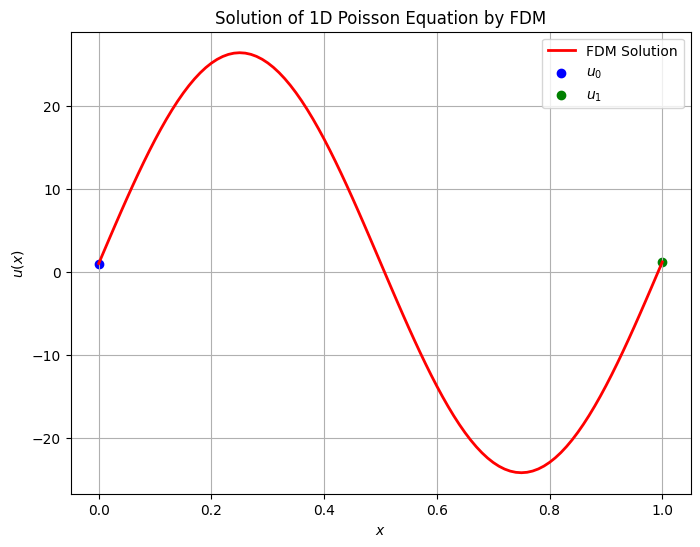

In [2]:
# Create a plot of the FDM solution
plt.figure(figsize=(8, 6))

# Plot the FDM solution across all points (including boundaries)
plt.plot(x_mesh, u_fdm, 'r-', linewidth=2, label='FDM Solution')

# Plot the boundary conditions explicitly
plt.scatter(x_mesh[0], u_fdm[0], color='blue', label='$u_0$')
plt.scatter(x_mesh[-1], u_fdm[-1], color='green', label='$u_1$')

plt.title('Solution of 1D Poisson Equation by FDM')
plt.xlabel('$x$')
plt.ylabel('$u(x)$')
plt.grid(True)
plt.legend()
plt.show()

### (1.2) Visualize the solution
**Note:** The problem has an explicit solution
$$u(x) = \frac{\sin(2\pi x)}{4\pi^2k} + (u_1-u_0)x+u_0.$$

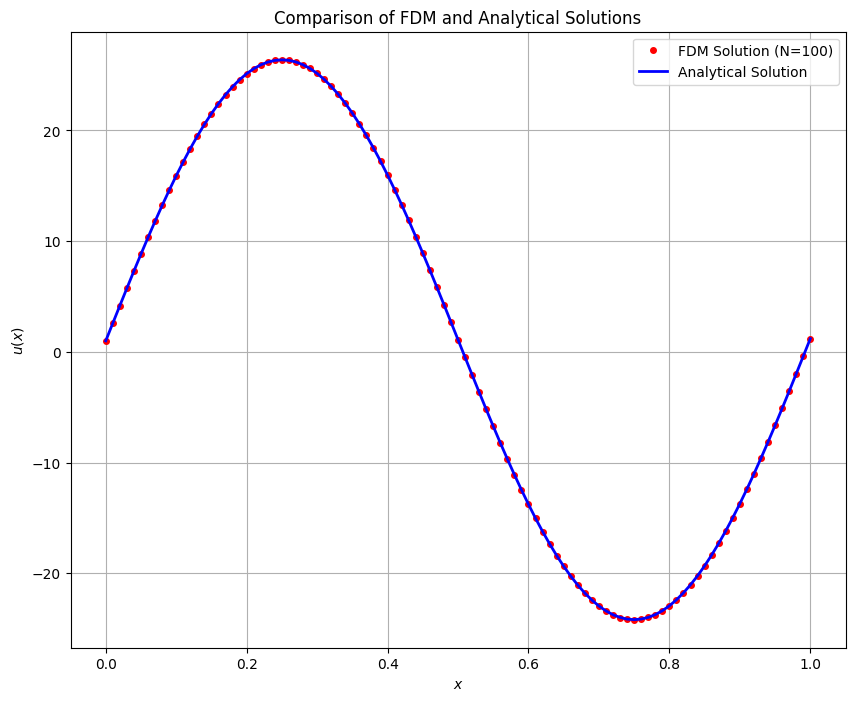

Maximum absolute error: 0.008334978525230241


In [3]:
# Calculate the analytical (true) solution
def get_true_sol(x, kapa, u0, u1):
    """
    Calculate the analytical solution for the 1D Poisson equation.
    """
    # u(x) = sin(2πx)/(4π^2*k) + (u_1-u_0)x + u_0
    u_true = np.sin(2 * np.pi * x) / (4 * np.pi**2 * kapa) + (u1 - u0) * x + u0
    return u_true

# Calculate the true solution on the same grid
u_true = get_true_sol(x_mesh, kapa, u0, u1)

# Plot both the FDM and true solution for comparison
plt.figure(figsize=(10, 8))
plt.plot(x_mesh, u_fdm, 'ro', markersize=4, label='FDM Solution (N=100)')
plt.plot(x_mesh, u_true, 'b-', linewidth=2, label='Analytical Solution')

plt.title('Comparison of FDM and Analytical Solutions')
plt.xlabel('$x$')
plt.ylabel('$u(x)$')
plt.legend()
plt.grid(True)
plt.show()

# Calculate the maximum absolute error
max_error = np.max(np.abs(u_fdm - u_true))
print(f"Maximum absolute error: {max_error}")

### (1.3) The accuracy
The relative $L^2$ error between the solution $u_{fdm}$ and the truth $u_{true}$ is defined as follows:
$$
error = \sqrt{\frac{\|u_{fdm}-u_{true}\|^2}{\|u_{true}\|^2}}
$$
#### Relationship between $L^2$ error and step size $\Delta x^2$
$$L^2 \propto \mathcal{O}(\Delta x^2)$$

In [4]:
error = np.sqrt(np.sum((u_true-u_fdm)**2)/np.sum(u_true**2))
print(error)

0.0003292501619529282


h_list ((dx)^2): [np.float64(0.010000000000000002), np.float64(0.0025000000000000005), np.float64(0.0006250000000000001), np.float64(0.00015625000000000003), np.float64(3.906250000000001e-05), np.float64(9.765625000000002e-06), np.float64(2.4414062500000005e-06)]
err_list (Relative L2 Error): [np.float64(0.03357010105065968), np.float64(0.00826960605997513), np.float64(0.002059880256217426), np.float64(0.0005145078224210694), np.float64(0.00012859885685331766), np.float64(3.2148054051864036e-05), np.float64(8.036921708337543e-06)]


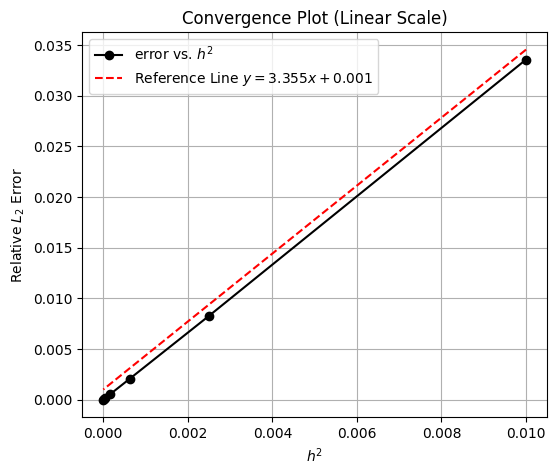

In [5]:
# Define a class to encapsulate the FDM solution for convenience
class FDM:
    '''
    A class to solve the 1D Poisson equation: -k u_xx = f(x)
    '''
    def __init__(self, N, kapa, u0, u1):
        '''
        Initializes the FDM solver with grid size and parameters.
        '''
        self.N = N
        self.kapa = kapa
        self.u0 = u0
        self.u1 = u1

        # Discretize the domain and calculate grid spacing
        self._x = np.linspace(0., 1., N+1)
        self._dx = self._x[1] - self._x[0]

        # Assemble and solve the system
        A = self.get_A(N, kapa, self._dx)
        b = self.get_b(N, kapa, self._dx, u0, u1)

        # Initialize solution vector
        self._u = np.zeros(N+1)
        self._u[0] = u0
        self._u[-1] = u1

        # Solve for interior points and store the solution
        self._u[1:-1] = np.linalg.solve(A, b)

    def get_A(self, N, kapa, dx):
        '''
        Construct the finite-difference stiffness matrix A.
        '''
        A = np.zeros(shape=(N-1, N-1))
        for j in range(N-1):
            if j > 0: # The lower diagonal
                A[j, j-1] = 1
            A[j, j] = - 2 # The main diagonal
            if j < N-2: # The upper diagonal
                A[j, j+1] = 1

        return -A * kapa / dx**2

    def get_b(self, N, kapa, dx, u0, uN):
        '''
        Construct the right-hand-side vector b.
        '''
        x = np.linspace(0., 1., N+1)
        # Forcing term f(x) = sin(2*pi*x)
        b = np.sin(2*np.pi*x[1:-1])

        # Boundary contributions
        b[0] += kapa * u0 / dx**2
        b[-1] += kapa * uN / dx**2

        return b

# Define the analytical solution function
# u(x) = sin(2πx)/(4π^2*k) + (u_1-u_0)x + u_0
def get_true_sol(x, kapa, u0, u1):
    u_true = np.sin(2 * np.pi * x) / (4 * np.pi**2 * kapa) + (u1 - u0) * x + u0
    return u_true


# List of grid sizes (number of subintervals) to test
N_list = [10, 20, 40, 80, 160, 320, 640]
err_list = []
h_list = [] # Will store (dx)**2

# Problem parameters
kapa = 0.001
u0 = 1.0
u1 = 1.2

# Loop over different N values, solve, and calculate error
for N in N_list:
    # Instantiate the solver and get the FDM solution
    sol = FDM(N, kapa, u0, u1)
    u_fdm = sol._u
    x = sol._x
    dx = sol._dx

    # Calculate the true solution on the current grid
    u_true = get_true_sol(x, kapa, u0, u1)

    # Calculate the relative L^2 error
    error = np.sqrt(np.sum((u_true - u_fdm)**2) / np.sum(u_true**2))
    err_list.append(error)

    # Store the square of the grid spacing (h = dx)
    h_list.append(dx**2)

# Print the results
print("h_list ((dx)^2):", h_list)
print("err_list (Relative L2 Error):", err_list)

# Plot the convergence rate
h_array = np.array(h_list)

plt.figure(figsize=(6,5))
# Plot the calculated error vs (dx)^2
plt.plot(h_array, err_list, 'ko-', label='error vs. $h^2$')
# Plot the reference line
plt.plot(h_array, 3.355*h_array + 0.001, 'r--', label='Reference Line $y=3.355x+0.001$')
plt.xlabel(r'$h^2$')
plt.ylabel(r'Relative $L_2$ Error')
plt.title('Convergence Plot (Linear Scale)')
plt.legend()
plt.grid(True)
plt.show()

### (2) Solving 1D heat equation with Python
$$
\begin{split}
\frac{\partial u}{\partial t} &= k \frac{\partial^2 u}{\partial x^2},\quad (x,t)\in \Omega_T=[0,1]\times[0,1] \\
 u(x,0) &= 0 \\
 u(0,t)=1,&\  u(1,t)=-1 \\
\end{split}
$$
where $k=1.$

### （2.1）The discretization of the PDE
We denote $u_i = u(x_i,t)$ and approximate the PDE as
\begin{equation}
\frac{d u_i}{dt} = k \frac{u_{i+1} - 2u_i + u_{i-1}}{\Delta x^2}, \quad i=1,\cdots,N-1. \tag{9}
\end{equation}
We denote
$$
\vec{u}(t) = [u_1, u_2, \cdots, u_{N-1}]^T.
$$
Then, the equations $(9)$ can be reformulated as the following linear system:
\begin{equation}
\frac{d \vec{u}(t)}{dt} =
\frac{k}{\Delta x^2}\left[
\begin{matrix}
-2 & 1 & \cdots & \cdots \\
1 & -2 & \cdots & \cdots \\
\vdots & \vdots & \ddots & 1\\
\cdots & \cdots & 1, & -2 \\
\end{matrix}
\right] \vec{u}
+
\left[
\begin{matrix}
\frac{k}{\Delta x^2}u_0 \\
0 \\
\cdots \\
0 \\
\frac{k}{\Delta x^2}u_N \\
\end{matrix}
\right]
\end{equation}
We denote it as:
$$
\frac{d\tilde{u}}{dt} = A\tilde{u} + b.
$$
The above ODE system is solved with the built-in method [```solve_ivp```](https://docs.scipy.org/doc/scipy/reference/generated/scipy.integrate.solve_ivp.html) in ```scipy.integrate```.

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp
from matplotlib import animation
from IPython.display import HTML

def get_A_heat(N, kapa, dx):
    '''
    Construct the matrix A for the 1D Heat Equation semi-discretization.
    A corresponds to the operator k * D_xx (where D_xx is the central difference matrix).
    '''
    # N-1 is the size of the matrix for interior points
    A = np.zeros(shape=(N-1, N-1))
    #
    for j in range(N-1):
        if j > 0: # The lower diagonal (u_{i-1})
            A[j, j-1] = 1
        A[j, j] = - 2 # The main diagonal (u_i)
        if j < N-2: # The upper diagonal (u_{i+1})
            A[j, j+1] = 1

    # Scale by kapa / dx**2 to represent k * u_xx
    return A * kapa / dx**2

def get_b_heat(N, kapa, dx, u0, uN):
    '''
    Construct the right-hand-side vector b for the 1D Heat Equation semi-discretization.
    This vector contains contributions from the fixed Dirichlet boundary conditions.
    '''
    b = np.zeros(N-1)
    #
    # The first equation (i=1) involves u_0. Term is: (k/dx^2) * u_0.
    b[0] = kapa * u0 / dx**2 # The left boundary contribution
    # The last equation (i=N-1) involves u_N. Term is: (k/dx^2) * u_N.
    b[-1] = kapa * uN / dx**2 # The right boundary contribution

    return b

##################################
# The value of kapa and boundary conditions
kapa = 1.
u0 = 1.  # u(0, t)
uN = -1. # u(1, t)

# Number of subintervals
N = 100
x_mesh = np.linspace(0, 1, N+1)
dx = x_mesh[1] - x_mesh[0]

# Assemble the matrix A and vector b
A = get_A_heat(N, kapa, dx)
b = get_b_heat(N, kapa, dx, u0, uN)

## Define the ODE function F(t, u) = A*u + b
F = lambda t, u: np.dot(A, u) + b

# Initial condition for interior points: u(x, 0) = 0
u_init = np.zeros(N-1)

# Time mesh for evaluation
t_mesh = np.linspace(0., 1., 1001)

# Solve the initial value problem (IVP)
# t_span=[0,1] is the integration interval, y0=u_init is the initial state,
# t_eval=t_mesh specifies the time points where the solution is desired.
sol = solve_ivp(F, t_span=[0,1], y0=u_init, t_eval=t_mesh)

# sol.t contains the time points, sol.y contains the solution at interior nodes
# sol.y shape: (N-1, len(t_mesh))
print(sol.t.shape)
print(sol.y.shape)

(1001,)
(99, 1001)


#### Visualization

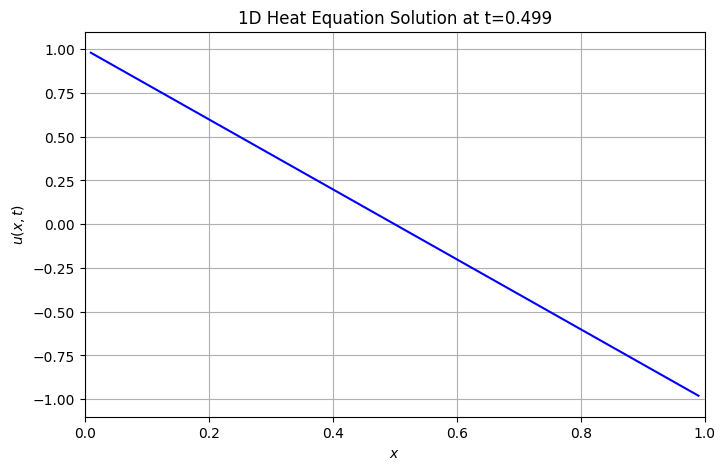

In [7]:
# Setup the figure for the animation
fig, ax = plt.subplots(figsize=(8, 5))
# Initialize the line plot with the solution at the first time step (t=0)
# Plot the solution for interior points (x_mesh[1:-1])
line, = ax.plot(x_mesh[1:-1], sol.y[:, 0], 'b-')

# Set limits
ax.set_ylim(min(u0, uN) - 0.1, max(u0, uN) + 0.1)
ax.set_xlim(0, 1)
ax.set_xlabel('$x$')
ax.set_ylabel('$u(x, t)$')
ax.set_title(f'1D Heat Equation Solution at t={sol.t[0]:.3f}')
ax.grid(True)

def animate(i):
    '''
    Function to update the plot data for each frame.
    i is the frame number (index in sol.t and sol.y).
    '''
    # Set the y-data to the solution at time step i
    line.set_ydata(sol.y[:, i])
    # Update the title to show the current time
    ax.set_title(f'1D Heat Equation Solution at t={sol.t[i]:.3f}')
    return line,

# Create the animation
# frames=500 uses the first 500 time points for the animation
# interval=10 is the delay between frames in milliseconds
# blit=True means only redraw the parts that have changed
ani = animation.FuncAnimation(fig, animate, frames=len(t_mesh)//2, interval=10, blit=True)

# Display the animation in the notebook
HTML(ani.to_jshtml())

#### Comparison with the result obtained by Matlab built-in algorithm

Reference solution 'u_true' loaded successfully.


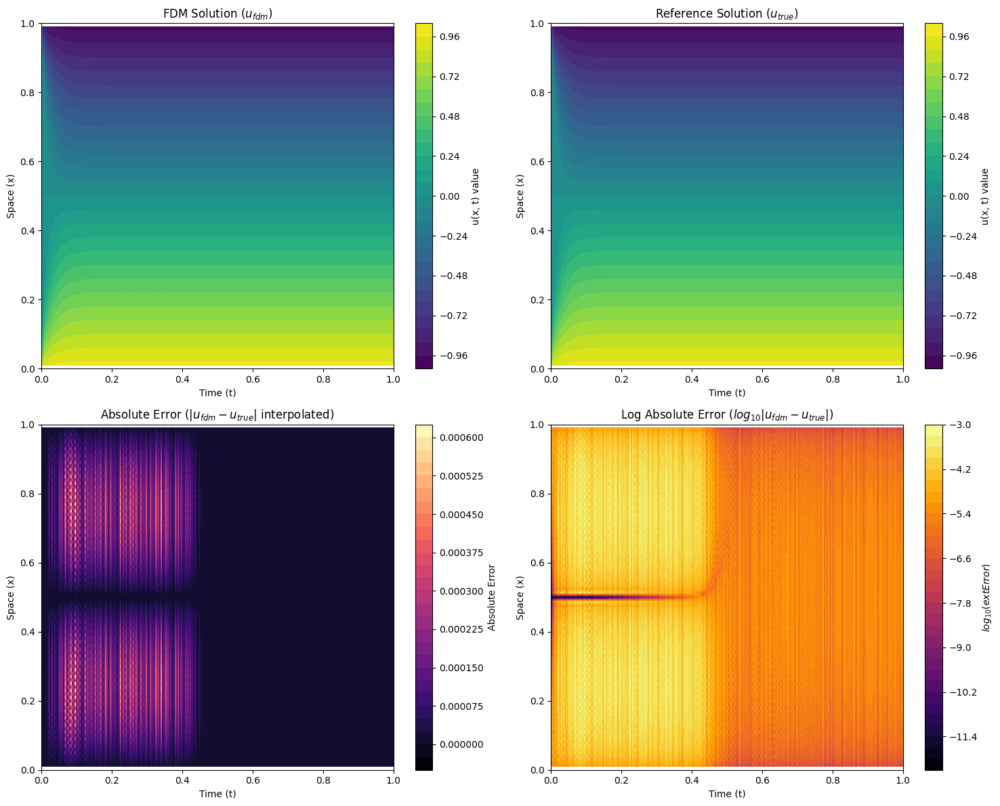

Maximum absolute error at any node: 6.0969e-04


In [30]:
import numpy as np
import h5py
import matplotlib.pyplot as plt
from scipy.interpolate import griddata

# Note: This code assumes 'sol', 't_mesh', and 'x_mesh' are defined
# from the previous FDM solution of the 1D Heat Equation.

## Load the result obtained by Matlab
try:
    with h5py.File('heat_1d.h5', 'r') as f:
        # Load the solution array from the HDF5 file.
        # [1:-1, :] slices to exclude the boundary points (x=0 and x=1) in space
        # to match the shape of the FDM solution 'sol.y'.
        u_true = np.array(f['sol'])[1:-1, :]
    print("Reference solution 'u_true' loaded successfully.")
except FileNotFoundError:
    print("Warning: 'heat_1d.h5' not found. Cannot load reference solution.")
    # Use FDM solution as a placeholder for u_true to prevent plotting crash.
    u_true = sol.y.copy()

u_fdm = sol.y # FDM solution from solve_ivp, shape (N-1, len(t_mesh))

# Prepare the mesh for interpolation
# Create a 2D array of time (tt) and space (xx) coordinates for the interior FDM nodes
# x_mesh[1:-1] are the interior x-coordinates (x_1 to x_{N-1})
tt, xx = np.meshgrid(t_mesh, x_mesh[1:-1])

# Stack time and space coordinates into a list of (t, x) points for griddata
tx_points = np.stack([tt.flatten(), xx.flatten()]).T # Shape (M*T, 2)

# Define the target grid for plotting (finer mesh for smoother contours)
# Time grid: 500 points from 0 to 1, Space grid: 200 points from 0 to 1
grid_t, grid_x = np.mgrid[0:1:500j, 0:1:200j]

# Plot (2x2 subplot)
fig, axes = plt.subplots(2, 2, figsize=(15, 12))

# ------------------------------------------------
# Subplot [0, 0]: FDM Solution
# ------------------------------------------------
# Interpolate the FDM solution (u_fdm) onto the target grid
grid_z_fdm = griddata(tx_points, u_fdm.flatten(), (grid_t, grid_x), method='cubic')
cntr1 = axes[0, 0].contourf(grid_t, grid_x, grid_z_fdm, levels=30, cmap="viridis")

axes[0, 0].set_xlabel("Time (t)")
axes[0, 0].set_ylabel("Space (x)")
axes[0, 0].set_title("FDM Solution ($u_{fdm}$)")
fig.colorbar(cntr1, ax=axes[0, 0], label="u(x, t) value")

# ------------------------------------------------
# Subplot [0, 1]: Reference Solution ($u_{true}$)
# ------------------------------------------------
# Interpolate the reference solution (u_true) onto the target grid
grid_z_true = griddata(tx_points, u_true.flatten(), (grid_t, grid_x), method='cubic')
cntr2 = axes[0, 1].contourf(grid_t, grid_x, grid_z_true, levels=30, cmap="viridis")

axes[0, 1].set_xlabel("Time (t)")
axes[0, 1].set_ylabel("Space (x)")
axes[0, 1].set_title("Reference Solution ($u_{true}$)")
fig.colorbar(cntr2, ax=axes[0, 1], label="u(x, t) value")

# ------------------------------------------------
# Subplot [1, 0]: Absolute Error
# ------------------------------------------------
# Calculate the absolute difference
absolute_error = np.abs(u_true - u_fdm)
grid_z_error = griddata(tx_points, absolute_error.flatten(), (grid_t, grid_x), method='cubic')

cntr3 = axes[1, 0].contourf(grid_t, grid_x, grid_z_error, levels=30, cmap="magma") # Using 'magma' for error clarity

axes[1, 0].set_xlabel("Time (t)")
axes[1, 0].set_ylabel("Space (x)")
axes[1, 0].set_title("Absolute Error ($|u_{fdm} - u_{true}|$ interpolated)")
fig.colorbar(cntr3, ax=axes[1, 0], label="Absolute Error")

# ------------------------------------------------
# Subplot [1, 1]: Log Absolute Error
# ------------------------------------------------
# To avoid log(0), we use a small epsilon (1e-12)
log_absolute_error = np.log10(absolute_error + 1e-12)
grid_z_log_error = griddata(tx_points, log_absolute_error.flatten(), (grid_t, grid_x), method='cubic')
cntr4 = axes[1, 1].contourf(grid_t, grid_x, grid_z_log_error, levels=30, cmap="inferno") # Use a different colormap

axes[1, 1].set_xlabel("Time (t)")
axes[1, 1].set_ylabel("Space (x)")
axes[1, 1].set_title("Log Absolute Error ($log_{10}|u_{fdm} - u_{true}|$)")
fig.colorbar(cntr4, ax=axes[1, 1], label="$log_{10}(\text{Error})$")

# Adjust layout
fig.tight_layout()
plt.show()

print(f"Maximum absolute error at any node: {np.max(np.abs(u_true - u_fdm)):.4e}")

### (3) Summary

In [ ]:
1, regular geometries
2, more grids, more accurate
3, numerical approximation for approximating derivatives
4, need interpolation to make predictions on random positions
5, curse-of-dimensionality

## Exercises

### Task 1: Solving the 1D Darcy’s Flow Problem with FDM

#### Problem Statement

Darcy’s law describes the flow of a fluid through a porous medium. In 1D, it is given by the steady-state equation:
$$
-\frac{d}{dx} \left( k(x) \frac{d p}{dx} \right) = f(x), \quad x \in [0,1]
$$
where:
- $p(x)$ is the pressure (unknown),
- $k(x)= (1 + \sin(\frac{3\pi}{2}x))/3$ is the permeability of the medium,
- $f(x)=\frac{3\pi^2}{4}(\cos(\frac{3\pi}{2}x)+\sin(3\pi x))$ is an external source term.

We impose Dirichlet boundary conditions:
$$
p(0) = 1, \quad p(1) = 0
$$

#### Discretization Using Finite Difference Method (FDM)

Using a uniform grid with N points and spacing $\Delta x$, we approximate:
$$
\begin{split}
\frac{d}{dx} \left( k(x) \frac{d p}{dx} \right) &\approx \frac{1}{\Delta x} \left[ k_{i+1/2} \frac{p_{i+1} - p_i}{\Delta x} - k_{i-1/2} \frac{p_i - p_{i-1}}{\Delta x} \right] \\
 & = \frac{1}{\Delta x^2}\left[k_{i+1/2} p_{i+1} -(k_{i+1/2}+k_{i-1/2})p_i + k_{i-1/2}p_{i-1} \right]
\end{split}
$$
where $k_{i+1/2}=\frac{k_i +k_{i+1}}{2}$ and $k_{i-1/2}=\frac{k_i+k_{i-1}}{2}$. Rearranging, we get a linear system:
$$
A \mathbf{p} = \mathbf{b}
$$
where:
- $A$ is a tridiagonal matrix,
- $\mathbf{p}$ is the vector of unknown pressures,
- $\mathbf{b}$ is the right-hand side including $f(x)$ and boundary conditions.

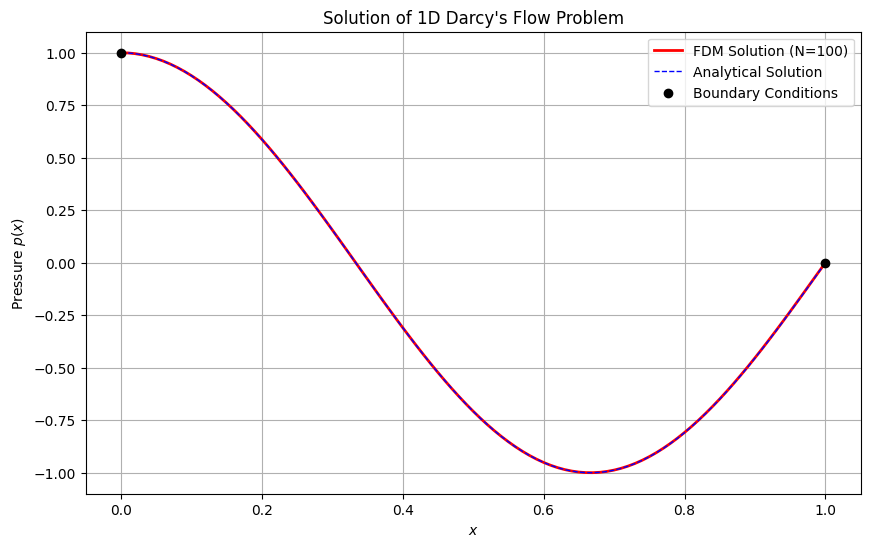

Grid Size N: 100
Relative L2 Error: 7.8387e-04


In [13]:
import numpy as np
import matplotlib.pyplot as plt

# Define Darcy Flow functions
def k_func(x):
    """Permeability function k(x)"""
    return (1 + np.sin(3 * np.pi * x / 2)) / 3

def f_func(x):
    """Source term f(x)"""
    return (3 * np.pi**2 / 4) * (np.cos(3 * np.pi * x / 2) + np.sin(3 * np.pi * x))

# Define the exact solution
def p_true(x):
    """
    Analytical solution for the Darcy's flow problem.
    """
    return np.cos(3 * np.pi * x / 2)

def solve_darcy_fdm_final_corrected(N, p0, pN):
    """
    Solves the 1D Darcy's flow problem using FDM with coefficients derived from
    the scaled stencil: k_{i-1/2} p_{i-1} - (k_{i+1/2}+k_{i-1/2})p_i + k_{i+1/2}p_{i+1} = dx^2 f_i
    """
    x_mesh = np.linspace(0, 1, N+1)
    dx = x_mesh[1] - x_mesh[0]
    M = N - 1 # Number of interior points (indices 1 to N-1)
    dx2 = dx**2

    # Get k values at all grid points (0 to N)
    k_i = k_func(x_mesh)

    # Get k values at half-points k_{i+1/2} (i = 0 to N-1)
    # k_half has N elements: k_{1/2}, k_{3/2}, ..., k_{N-1/2}
    k_half = (k_i[:-1] + k_i[1:]) / 2

    # Initialize the (N-1) x (N-1) stiffness matrix A
    A = np.zeros(shape=(M, M))

    # Construct the matrix A for interior points (i=1 to N-1, or index 0 to M-1)
    for i in range(M):
        # The coefficients A are independent of dx^2 in this scaled form.

        # k_{i+1/2} corresponds to k_half[i+1]
        k_plus_half = k_half[i+1]

        # Determine k_{i-1/2}
        if i == 0:
            # For i=0 (p_1), k_{i-1/2} is k_{1/2} (k_half[0])
            k_minus_half = k_half[0]
        else:
            # For i > 0, k_{i-1/2} is k_half[i]
            k_minus_half = k_half[i]

        # Main diagonal (coefficient for p_{i+1}, index i)
        A[i, i] = -(k_plus_half + k_minus_half)

        # Upper diagonal (coefficient for p_{i+2}, index i+1)
        if i < M - 1:
            A[i, i+1] = k_plus_half

        # Lower diagonal (coefficient for p_{i}, index i-1)
        if i > 0:
            A[i, i-1] = k_minus_half

    # Construct the right-hand side vector b
    # RHS is -dx^2 * f(x) evaluated at interior points x_1 to x_{N-1}
    f_i = f_func(x_mesh[1:-1])
    b = -dx2 * f_i

    # Apply boundary conditions (A_{int} p_{int} = b - A_{bnd} p_{bnd}):
    # Left Boundary (i=1 or index 0 in b): b_0 = b_0 - k_{1/2} * p_0
    # The term to subtract is k_{1/2} p_0. k_{1/2} is k_half[0]
    b[0] -= k_half[0] * p0

    # Right Boundary (i=N-1 or index M-1 in b): b_{N-2} = b_{N-2} - k_{N-1/2} * p_N
    # The term to subtract is k_{N-1/2} p_N. k_{N-1/2} is k_half[M]
    b[M-1] -= k_half[M] * pN

    # Solve the linear system A p_interior = b
    p_interior = np.linalg.solve(A, b)

    # Reconstruct the full pressure vector
    p_fdm = np.zeros(N+1)
    p_fdm[0] = p0
    p_fdm[-1] = pN
    p_fdm[1:-1] = p_interior

    return x_mesh, p_fdm

# Parameters
N_darcy = 100
p0 = 1.0
pN = 0.0

x_darcy, p_fdm_darcy = solve_darcy_fdm_final_corrected(N_darcy, p0, pN)

# Calculate the true solution
p_true_darcy = p_true(x_darcy)

# Calculate the relative L^2 error
error_darcy = np.sqrt(np.sum((p_true_darcy - p_fdm_darcy)**2) / np.sum(p_true_darcy**2))

# Visualize
plt.figure(figsize=(10, 6))
plt.plot(x_darcy, p_fdm_darcy, 'r-', linewidth=2, label=f'FDM Solution (N={N_darcy})')
plt.plot(x_darcy, p_true_darcy, 'b--', linewidth=1, label='Analytical Solution')
plt.scatter([0, 1], [p0, pN], color='k', zorder=5, label='Boundary Conditions')

plt.title('Solution of 1D Darcy\'s Flow Problem')
plt.xlabel('$x$')
plt.ylabel('Pressure $p(x)$')
plt.grid(True)
plt.legend()
plt.show()

print(f"Grid Size N: {N_darcy}")
print(f"Relative L2 Error: {error_darcy:.4e}")

### Task2: Solving the 2d Poisson Equation using FDM

#### The 2d Poisson Equation

The Poisson equation models steady-state problems in physics, such as electrostatics and heat conduction:
$$
-\nabla^2 u = - \left(\frac{\partial^2 u}{\partial x^2}+\frac{\partial^2 u}{\partial y^2}\right) = f(x, y), \quad (x,y) \in \Omega
$$
where $f(x,y)=2\pi^2\sin(\pi x)\sin(\pi y)$ and Dirichlet boundary condition is considered:
$$
u(x,y) = 0, \quad (x,y) \in \partial \Omega
$$

#### Numerical Discretization (Finite Difference Method)

Using central difference approximation, we discretize the Laplace operator on a uniform grid with $(N+2) \times (N+2)$ points:
$$
- \left(\frac{u_{i-1,j} - 2u_{i,j} + u_{i+1,j}}{\Delta x^2} + \frac{u_{i,j-1} - 2u_{i,j} + u_{i,j+1}}{\Delta y^2}\right)= f_{i,j}
$$
For a uniform grid $\Delta x = \Delta y = h$, the equation simplifies to:
$$
-\frac{1}{h^2}\left(u_{i+1,j} + u_{i-1,j} + u_{i,j+1} + u_{i,j-1} - 4u_{i,j}\right) =f_{i,j}.
$$

<p align="center">
  <img src="https://github.com/matthewshawnkehoe/Deep-Learning-for-PDEs-in-Engineering-Physics-2025-Summer/blob/main/Week4_FDM/FDM_grid.jpg?raw=true" alt="FDM_grid" width="500" height='600'/>
</p>
<p align="center">
  <em>Fig. 1: Illustration of the Grid and Stencil</em>
</p>

This forms a linear system:
$$
A u = b
$$
where:
- $A$ is a sparse block-tridiagonal matrix of size $N^2 \times N^2$,
- $\vec{u}=[u_{1,1},\cdots,u_{1,N},\cdots,u_{N,1},\cdots,u_{N,N}]$ is the unknown solution vector,
- $b$ is the right-hand side containing $f(x,y)$.

**Example for N=3 (3x3 interior grid):**

For a $3 \times 3$ interior grid, the unknown vector $u$ is ordered as:
$$
u = [u_{1,1}, u_{1,2}, u_{1,3}, u_{2,1}, u_{2,2}, u_{2,3}, u_{3,1}, u_{3,2}, u_{3,3}]
$$
The corresponding matrix $A$ is:
$$
A = -\frac{1}{h^2}
\begin{bmatrix}
-4 & 1  & 0  & 1  & 0  & 0  & 0  & 0  & 0  \\
1  & -4 & 1  & 0  & 1  & 0  & 0  & 0  & 0  \\
0  & 1  & -4 & \color{red}{0}  & 0  & 1  & 0  & 0  & 0  \\
1  & 0  & \color{red}{0}  & -4 & 1  & 0  & 1  & 0  & 0  \\
0  & 1  & 0  & 1  & -4 & 1  & 0  & 1  & 0  \\
0  & 0  & 1  & 0  & 1  & -4 & \color{red}{0}  & 0  & 1  \\
0  & 0  & 0  & 1  & 0  & \color{red}{0}  & -4 & 1  & 0  \\
0  & 0  & 0  & 0  & 1  & 0  & 1  & -4 & 1  \\
0  & 0  & 0  & 0  & 0  & 1  & 0  & 1  & -4 \\
\end{bmatrix}
$$

#### Steps to Solve the Problem
- **Discretize the domain** with grid spacing $h = \frac{1}{N+1}$.
- Assemble the finite difference **matrix A**.
- Construct the right-hand side **vector b**.
- **Solve the linear system $Au = b$** using an iterative solver (e.g., Conjugate Gradient) or a direct solver (e.g., LU decomposition).
- **Visualize the solution $u(x,y)$** using contour and surface plots.

Relative L2 Error for N=100: 2.8805e-15


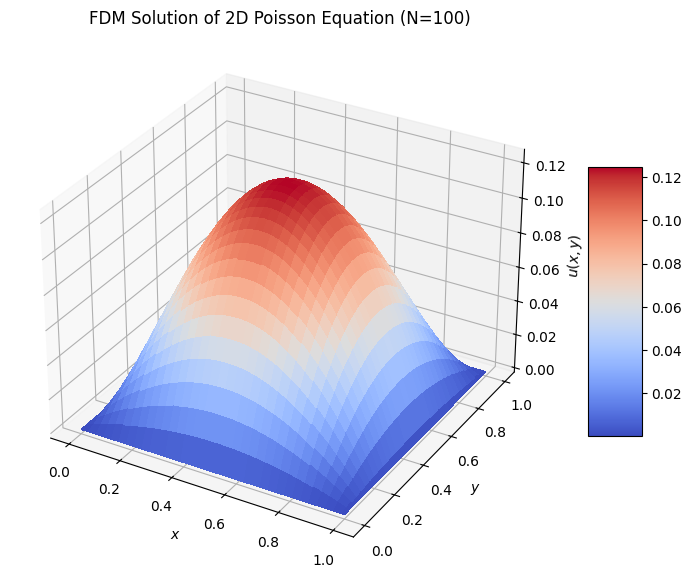

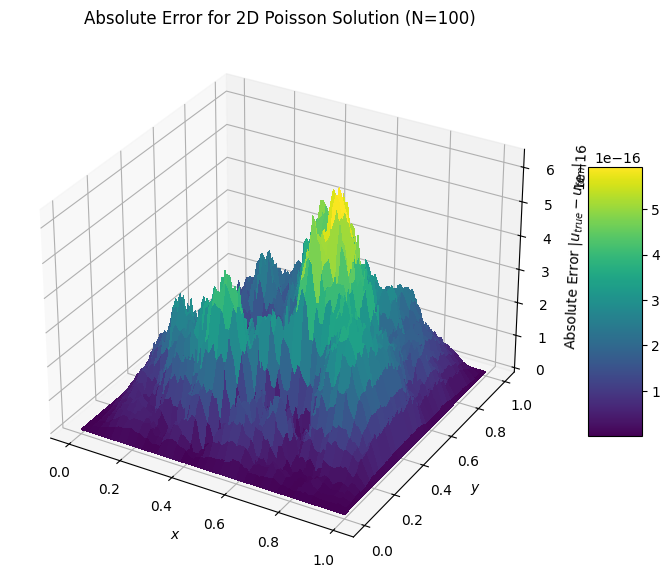

In [14]:
import numpy as np
from scipy.sparse import lil_matrix, kron, identity
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

class FDM2D:
    '''
    A class to solve the 2D Poisson equation: -Laplacian(u) = f(x, y)
    '''
    def __init__(self, N):
        '''
        Initializes the 2D FDM solver.
        N is the number of subintervals in one direction.
        The number of interior points in each direction is M = N-1.
        Total unknowns = M*M.
        '''
        self.N = N
        self.M = N - 1  # Number of interior points in each direction
        self.h = 1.0 / N  # Grid spacing h = dx = dy

        # Discretize the domain and create coordinate arrays for interior points
        self.x_mesh = np.linspace(0, 1, N + 1)
        self.y_mesh = np.linspace(0, 1, N + 1)

        # Get the matrix A and vector b
        # A corresponds to the operator: (Laplacian stencil * -1) * h^2
        A = self.get_A(self.M)
        b = self.get_b(self.M, self.h)

        # Solve the linear system A*u = b
        # The matrix A is sparse, but we convert it to dense for np.linalg.solve
        u_interior = np.linalg.solve(A.todense(), b)

        # Reshape the 1D solution vector into an M x M grid
        self._u_interior = u_interior.reshape((self.M, self.M))

        # Create the full (N+1) x (N+1) solution array, including boundary points
        self._u_full = np.zeros((N + 1, N + 1))
        # Place the interior solution (M x M) into the full grid
        # Note on indexing: M = N-1, so 1:N spans the interior (from x_1 to x_{N-1})
        self._u_full[1:N, 1:N] = self._u_interior

    def get_A(self, M):
        '''
        Construct the M^2 x M^2 matrix A for the 2D Laplacian.
        A has -4 on the main diagonal, 1 on the 1st off-diagonals (x-neighbors),
        and 1 on the M-th off-diagonals (y-neighbors).
        The implemented matrix A corresponds to the 5-point stencil operator
        multiplied by -1.
        '''
        # 1. Create the M x M 1D second derivative matrix T (T_i,i = -2, T_i,i±1 = 1)
        # This matrix T represents: u_{i-1} - 2*u_i + u_{i+1}
        T = np.diag([-2] * M) + np.diag([1] * (M - 1), 1) + np.diag([1] * (M - 1), -1)

        # I_M is the M x M identity matrix
        I_M = identity(M, format='lil')

        # The full 2D matrix A is constructed using Kronecker products (tensor product)
        # The 2D Laplacian stencil is: (T_x + T_y) / h^2
        # where T_x = I_M x T, T_y = T x I_M
        # A_y (long-range neighbors, distance M)
        A_y = kron(T, I_M, format='lil')

        # A_x (short-range neighbors, distance 1)
        A_x = kron(I_M, T, format='lil')

        # The full matrix A = -1 * (A_x + A_y).
        # A_x + A_y already has -4 on the diagonal and 1 on the off-diagonals.
        # This means A = A_x + A_y corresponds to the operator:
        # (u_{i+1,j} + u_{i-1,j} + u_{i,j+1} + u_{i,j-1} - 4*u_{i,j})
        A = A_x + A_y

        # Note: The system solved is A*u = b, where A is the discretized Laplacian
        # multiplied by -h^2, and b is -h^2 * f(x,y).
        # We need A = (Laplacian stencil * h^2 * -1)
        # Since the system is $\Delta u = -f$, or $\frac{1}{h^2} \times (\text{stencil}) = -f$
        # $\text{stencil} = -h^2 f$.
        # The implemented A is the stencil itself, so we need $A\vec{u} = -h^2\vec{f}$.
        return A

    def get_b(self, M, h):
        '''
        Construct the right-hand-side vector b for the system A*u = b.
        b = -h^2 * f(x, y).

        f(x, y) = 4(x(1-x) + y(1-y))
        '''
        # Create an M x M grid of interior coordinates
        x_interior = self.x_mesh[1:self.N]
        y_interior = self.y_mesh[1:self.N]
        # X and Y are M x M matrices of coordinates, using ij indexing (row=x, col=y)
        X, Y = np.meshgrid(x_interior, y_interior, indexing='ij')

        # Evaluate the forcing function f(x, y) on the interior grid
        f_xy = 4 * (X * (1 - X) + Y * (1 - Y))

        # The RHS vector b = -h^2 * f(x, y)
        b = - (h**2) * f_xy

        # Flatten the M x M grid into a 1D vector (lexicographical order)
        return b.flatten()

    def get_true_sol(self):
        '''
        Calculate the analytical solution on the full grid.
        u(x, y) = 2x(1-x)y(1-y)
        '''
        # X and Y are (N+1) x (N+1) matrices of coordinates, using ij indexing
        X, Y = np.meshgrid(self.x_mesh, self.y_mesh, indexing='ij')
        u_true = 2 * X * (1 - X) * Y * (1 - Y)
        return u_true

    def get_error(self):
        '''
        Calculate the L2 relative error between the FDM and true solution.
        Error = ||u_true - u_fdm|| / ||u_true||
        '''
        u_true = self.get_true_sol()

        # Calculate the discrete L2 norm (sum of squares)
        error_norm = np.sqrt(np.sum((u_true - self._u_full)**2))
        true_norm = np.sqrt(np.sum(u_true**2))

        # Relative error
        relative_error = error_norm / true_norm
        return relative_error

# Set the grid size (e.g., 100 subintervals)
N_solve = 100

# Solve the 2D Poisson equation
sol_2d = FDM2D(N_solve)

# Get the computed and true solutions
u_fdm_2d = sol_2d._u_full
u_true_2d = sol_2d.get_true_sol()
error_2d = sol_2d.get_error()
print(f"Relative L2 Error for N={N_solve}: {error_2d:.4e}")

# Visualization of the FDM solution
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

X, Y = np.meshgrid(sol_2d.x_mesh, sol_2d.y_mesh, indexing='ij')

# Plot the surface
surf = ax.plot_surface(X, Y, u_fdm_2d, cmap=plt.cm.coolwarm,
                       linewidth=0, antialiased=False)

# Add labels and title
ax.set_xlabel('$x$')
ax.set_ylabel('$y$')
ax.set_zlabel('$u(x, y)$')
ax.set_title(f'FDM Solution of 2D Poisson Equation (N={N_solve})')

# Add a color bar
fig.colorbar(surf, shrink=0.5, aspect=5)
plt.show()

# Visualization of the absolute error |u_true - u_fdm|
error_plot = np.abs(u_true_2d - u_fdm_2d)

fig_err = plt.figure(figsize=(10, 7))
ax_err = fig_err.add_subplot(111, projection='3d')
surf_err = ax_err.plot_surface(X, Y, error_plot, cmap=plt.cm.viridis,
                               linewidth=0, antialiased=False)

ax_err.set_xlabel('$x$')
ax_err.set_ylabel('$y$')
ax_err.set_zlabel('Absolute Error $|u_{true} - u_{fdm}|$')
ax_err.set_title(f'Absolute Error for 2D Poisson Solution (N={N_solve})')
fig_err.colorbar(surf_err, shrink=0.5, aspect=5)
plt.show()